<a href="https://colab.research.google.com/github/Rifqi22/pygmtsar_thesis/blob/main/Thesis_Cianjur_November_2022_Earthquake_PyGMTSAR_11Nov_03Feb.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

$\Large\color{grey}{\text{THESIS}}$

$\Large\color{grey}{\text{PyGMTSAR 2022 Cianjur Earthquake Co-Seismic Interferogram}}$

$\large\color{grey}{\text{2023}}$

$\large\color{grey}{\text{11 Nov 2022& 03 Feb 2023}}$




$\large\color{}{\text{About}}$

I'm an undergraduate (5th semester) GIScience student from Universitas Pendidikan Indonesia. I have great passion in the fields of Geographic Information Systems (GIS), Remote Sensing, Regional Mapping Surveys, and Cartography. Currently upskilling in GIS and Cartography, and constant looking for a collaboration for a better learning experience.

### Media Social

* [Instagram]

* [GitHub](https://github.com/mobigroup),

* [LinkedIn](https://www.linkedin.com/in/mochammadrifqinaufalalfayyadh/),


### @ Mochammad Rifqi Naufal Alfayyadh, 2023

$\large\color{blue}{\text{Hint: Use menu Cell} \to \text{Run All or Runtime} \to \text{Complete All or Runtime} \to \text{Run All}}$
$\large\color{blue}{\text{(depending of your localization settings) to execute the entire notebook}}$

## Load Modules to Check Environment

In [ ]:
import platform, sys, os

## Google Colab Installation

### Install GMTSAR
https://github.com/gmtsar/gmtsar

In [ ]:
if 'google.colab' in sys.modules:
    count = !ls /usr/local | grep GMTSAR | wc -l
    if count == ['0']:
        !apt install -y csh autoconf gfortran \
            libtiff5-dev libhdf5-dev liblapack-dev libgmt-dev gmt-dcw gmt-gshhg gmt > /dev/null
        # GMTSAR codes are not so good to be compiled by modern GCC
        !apt install gcc-9
        !update-alternatives --install /usr/bin/gcc gcc /usr/bin/gcc-9 10
        !update-alternatives --config gcc
        !gcc --version
        !rm -fr /usr/local/GMTSAR
        !cd /usr/local && git clone --branch master https://github.com/gmtsar/gmtsar GMTSAR > /dev/null
        # revert recent broken commit
        !cd /usr/local/GMTSAR && git checkout e98ebc0f4164939a4780b1534bac186924d7c998 > /dev/null
        !cd /usr/local/GMTSAR && autoconf > /dev/null
        !cd /usr/local/GMTSAR && ./configure --with-orbits-dir=/tmp > /dev/null
        !cd /usr/local/GMTSAR && make 1>/dev/null 2>/dev/null
        !cd /usr/local/GMTSAR && make install >/dev/null
        # fix for missed script, use bash instead of csh interpretator
        # note: csh messes stdout and stderr in Docker environment, it's resolved in PyGMTSAR code
        !echo '#!/bin/sh' > /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !echo echo /usr/local/GMTSAR/share/gmtsar >> /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !chmod a+x /usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        !/usr/local/GMTSAR/bin/gmtsar_sharedir.csh
        # test one GMTSAR binary
        !/usr/local/GMTSAR/bin/make_s1a_tops

### Define ENV Variables for Jupyter Instance

In [ ]:
# use default GMTSAR installation path
PATH = os.environ['PATH']
if PATH.find('GMTSAR') == -1:
    PATH = os.environ['PATH'] + ':/usr/local/GMTSAR/bin/'
    %env PATH {PATH}

### Install Python Modules

Maybe you need to restart your notebook, follow the instructions printing below.

The installation takes a long time on fresh Debian 10 and a short time on Google Colab

In [ ]:
!{sys.executable} --version

Python 3.10.12


In [ ]:
if 'google.colab' in sys.modules:
    !{sys.executable} -m pip install matplotlib seaborn geoviews hvplot datashader bokeh >/dev/null

In [ ]:
!{sys.executable} -m pip install pygmtsar >/dev/null

## Load and Setup Python Modules

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
# supress numpy warnings
import warnings
warnings.filterwarnings('ignore')
from dask.distributed import Client

In [ ]:
# plotting modules
from IPython.display import Image
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

In [ ]:
# define Pandas display settings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', 100)

In [ ]:
from pygmtsar import SBAS

## Define 3 Sentinel-1 SLC Scenes and Processing Parameters

When you need more scenes and SBAS analysis  see examples on PyGMTSAR GitHub page https://github.com/mobigroup/gmtsar

### Descending Orbit Configuration

In [ ]:
#SCENES = ['S1A_IW_SLC__1SDV_20171112T030148_20171112T030216_019226_0208EC_EC55',
#          'S1B_IW_SLC__1SDV_20171118T030054_20171118T030121_008330_00EBEB_FE01',
#          'S1B_IW_SLC__1SDV_20171118T030119_20171118T030146_008330_00EBEB_2F6B']
#ORBIT        = 'D'
#SUBSWATH     = 1

### Ascending Orbit Configuration

In [ ]:
"""

Sentinel Pra Gempabumi 11 November 2022 'S1A_IW_SLC__1SDV_20221111T111506_20221111T111536_045845_057C1D_22C2'
Sentinel Pasca Gempabumi 23 November 2022 'S1A_IW_SLC__1SDV_20221123T111506_20221123T111536_046020_058209_DD11'
Sentinel Pasca Gempabumi 5 Desember 2022 'S1A_IW_SLC__1SDV_20221205T111506_20221205T111535_046195_0587FF_EF33'
Sentinel Pasca Gempabumi 17 Desember 2022 'S1A_IW_SLC__1SDV_20221217T111505_20221217T111535_046370_058DF6_BFA8'
Sentinel Pasca Gempabumi 03 Februari 2023 'S1A_IW_SLC__1SDV_20230203T111503_20230203T111533_047070_05A589_1A87'

"""

SCENES = ['S1A_IW_SLC__1SDV_20221111T111506_20221111T111536_045845_057C1D_22C2',
          'S1A_IW_SLC__1SDV_20230203T111503_20230203T111533_047070_05A589_1A87']
ORBIT        = 'A'
SUBSWATH     = 123

In [ ]:
#from google.colab import drive
#drive.mount('/content/drive')

In [ ]:
WORKDIR      = 'raw_cianjur'
DATADIR      = 'data_cianjur'
DEMFILE      = None
POLARIZATION = 'VV'
CORRLIMIT    = 0.10
DEFOMAX      = 0

## Download and Unpack Datasets

### Input ASF (Earthdata) User and Password

When data directory does not exists or empty the Sentinel-1 scenes downloaded from Alaska Satellite Facility (ASF) datastore. Use your Earthdata Login credentials. If you do not have a Earthdata Login, create one at https://urs.earthdata.nasa.gov//users/new

In [ ]:
# Username : Rifqi2207
# Password : Ikiw.2002

if os.path.isdir(DATADIR) and len([fname for fname in os.listdir(DATADIR) if fname[0]!='.'])>0:
    print ('Data directory already exists and it is not empty, miss downloading')
else:
    import time
    import getpass
    print ('Data directory does not exists or it is empty, download the dataset')
    # to print the message BEFORE the usename and password fields
    time.sleep(1)
    username = getpass.getpass('Please enter your ASF username and press Enter key:')
    password = getpass.getpass('Please enter your ASF password and press Enter key:')
    # download the scenes from ASF and unpack only required files to data directory
    for scene in SCENES:
        url = f'https://datapool.asf.alaska.edu/SLC/S{scene[2:3]}/{scene}.zip'
        !wget --user={username} --password={password} -qc {url}
        for subswath in str(SUBSWATH):
            !unzip -j -n {scene}.zip '*.SAFE/*/s1?-iw{subswath}-slc-{POLARIZATION.lower()}-*' -d {DATADIR}

Data directory already exists and it is not empty, miss downloading


## Run Local Dask Cluster

Launch Dask cluster for local and distributed multicore computing. That's possible to process terabyte scale Sentinel-1 SLC datasets on Apple Air 16 GB RAM.

In [ ]:
client = Client()
client

INFO:distributed.scheduler:State start
INFO:distributed.scheduler:  Scheduler at:     tcp://127.0.0.1:46047
INFO:distributed.scheduler:  dashboard at:  http://127.0.0.1:40573/status
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:35593'
INFO:distributed.nanny:        Start Nanny at: 'tcp://127.0.0.1:34983'
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:35821', name: 1, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:35821
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:60070
INFO:distributed.scheduler:Register worker <WorkerState 'tcp://127.0.0.1:45623', name: 0, status: init, memory: 0, processing: 0>
INFO:distributed.scheduler:Starting worker compute stream, tcp://127.0.0.1:45623
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:60068
INFO:distributed.scheduler:Receive client connection: Client-b0bab993-6e21-11ee-8122-0242ac1c000

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:40573/status,
Dashboard: http://127.0.0.1:40573/status,Workers: 2
Total threads: 2,Total memory: 12.68 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:46047,Workers: 2
Dashboard: http://127.0.0.1:40573/status,Total threads: 2
Started: Just now,Total memory: 12.68 GiB
Comm: tcp://127.0.0.1:45623,Total threads: 1
Dashboard: http://127.0.0.1:34279/status,Memory: 6.34 GiB
Nanny: tcp://127.0.0.1:35593,


## Init SBAS

Search recursively for measurement (.tiff) and annotation (.xml) and orbit (.EOF) files in the DATA directory. It can be directory with full unzipped scenes (.SAFE) subdirectories or just a directory with the list of pairs of required .tiff and .xml files (maybe pre-filtered for orbit, polarization and subswath to save disk space). If orbit files and DEM are missed these will be downloaded automatically below.

### Reuse Backup Dataset If Exists (uncomment the code below if needed)

When the full dataset is already downloaded and processing `SBAS.backup()` command allows to save the-preprocessed stitched and cropped scenes and DEM and orbit files into the specified directory and reuse the dataset later. By this way you can process a big dataset on cloud environment for the first time and download the pre-processed small dataset to continue work on your local computer or on Google Colab.

### Select Original Scenes and Download DEM and Orbits Later

Use filters to find required subswath, polarization and orbit in original scenes .SAFE directories in the data directory.

In [ ]:
sbas = SBAS(DATADIR, DEMFILE, basedir=WORKDIR,
            filter_orbit=ORBIT,
            filter_subswath=SUBSWATH,
            filter_polarization=POLARIZATION)

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-11-11,2022-11-11 11:15:06,A,S1A,VV,1,data_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.tiff,data_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.xml,None,"POLYGON ((106.92252 -8.22835, 106.55333 -6.54101, 105.75450 -6.71580, 106.12370 -8.40313, 106.92..."
2022-11-11,2022-11-11 11:15:07,A,S1A,VV,2,data_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.tiff,data_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.xml,None,"POLYGON ((107.69566 -7.99355, 107.32106 -6.30857, 106.48703 -6.49400, 106.86163 -8.17897, 107.69..."
2022-11-11,2022-11-11 11:15:08,A,S1A,VV,3,data_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.tiff,data_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.xml,None,"POLYGON ((108.35992 -7.78100, 107.98226 -6.09926, 107.25623 -6.26230, 107.63389 -7.94404, 108.35..."
2023-02-03,2023-02-03 11:15:03,A,S1A,VV,1,data_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.tiff,data_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.xml,None,"POLYGON ((106.92155 -8.22876, 106.55227 -6.54093, 105.75345 -6.71570, 106.12273 -8.40353, 106.92..."
2023-02-03,2023-02-03 11:15:04,A,S1A,VV,2,data_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.tiff,data_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.xml,None,"POLYGON ((107.69481 -7.99381, 107.32015 -6.30846, 106.48597 -6.49391, 106.86063 -8.17925, 107.69..."
2023-02-03,2023-02-03 11:15:05,A,S1A,VV,3,data_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.tiff,data_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.xml,None,"POLYGON ((108.35894 -7.78104, 107.98130 -6.09929, 107.25520 -6.26234, 107.63284 -7.94409, 108.35..."


### Download Sentinel-1 Orbits

The function below downloads orbit files.
Besides, for faster processing we can automatically use pre-downloaded orbit files in data directory.

In [ ]:
# also, we can place pre-downloaded orbit files to data directory
sbas.download_orbits()

MD5 checksumming:   0%|          | 0.00/4.41M [00:00<?, ?B/s]

MD5 checksumming:   0%|          | 0.00/4.65M [00:00<?, ?B/s]

Fetching archival status: 100%|##########| 1/1 [00:03<00:00,  3.15s/product]

### Show the Dataset

All the orbit files found, see 'orbitpath' column

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-11-11,2022-11-11 11:15:06,A,S1A,VV,1,data_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.tiff,data_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((106.92252 -8.22835, 106.55333 -6.54101, 105.75450 -6.71580, 106.12370 -8.40313, 106.92..."
2022-11-11,2022-11-11 11:15:07,A,S1A,VV,2,data_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.tiff,data_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((107.69566 -7.99355, 107.32106 -6.30857, 106.48703 -6.49400, 106.86163 -8.17897, 107.69..."
2022-11-11,2022-11-11 11:15:08,A,S1A,VV,3,data_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.tiff,data_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((108.35992 -7.78100, 107.98226 -6.09926, 107.25623 -6.26230, 107.63389 -7.94404, 108.35..."
2023-02-03,2023-02-03 11:15:03,A,S1A,VV,1,data_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.tiff,data_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((106.92155 -8.22876, 106.55227 -6.54093, 105.75345 -6.71570, 106.12273 -8.40353, 106.92..."
2023-02-03,2023-02-03 11:15:04,A,S1A,VV,2,data_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.tiff,data_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((107.69481 -7.99381, 107.32015 -6.30846, 106.48597 -6.49391, 106.86063 -8.17925, 107.69..."
2023-02-03,2023-02-03 11:15:05,A,S1A,VV,3,data_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.tiff,data_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((108.35894 -7.78104, 107.98130 -6.09929, 107.25520 -6.26234, 107.63284 -7.94409, 108.35..."


## Additional Data Filtering

All the scenes stored internally as a Pandas DataFrame "df" inside the SBAS object. So we are able to use Pandas operations on the sbas.df for additional scenes filtering and so on. Maybe, do you need to select just a few of scenes for a selected date range? In this case check the code below and adopt it for you.

In [ ]:
# select scenes for the date range
#sbas.df = sbas.df.query('"2020-11-01" <= index <= "2020-11-30"')
#sbas.df

In [ ]:
# select first 2 scenes only
#sbas.df = sbas.df.head(2)
#sbas.df

## Reframe Scenes (Optional)

Stitch sequential scenes and crop the subswath to a smaller area for faster processing when the full area is not needed.

### Define Pair of Pins for Each Subswath (Optional)

To create a stitched and maybe cropped frame two pins should be defined. Use the plots below to define the pins coordinates. Hint: in case of an error you see the notes how to fix the issues and you are still able to map the pins using the code below (anyway the issues should be fixed to continue the calculations).

This step can be missed and for this case automatically generated pins cover the full master image.

In [ ]:
# just miss the function call or run it without arguments to auto-pinning
sbas.set_pins()

NOTE subswath 1: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 1: pin2 is not defined, master image corner coordinate will be used
NOTE subswath 2: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 2: pin2 is not defined, master image corner coordinate will be used
NOTE subswath 3: pin1 is not defined, master image corner coordinate will be used
NOTE subswath 3: pin2 is not defined, master image corner coordinate will be used


### Static Plot

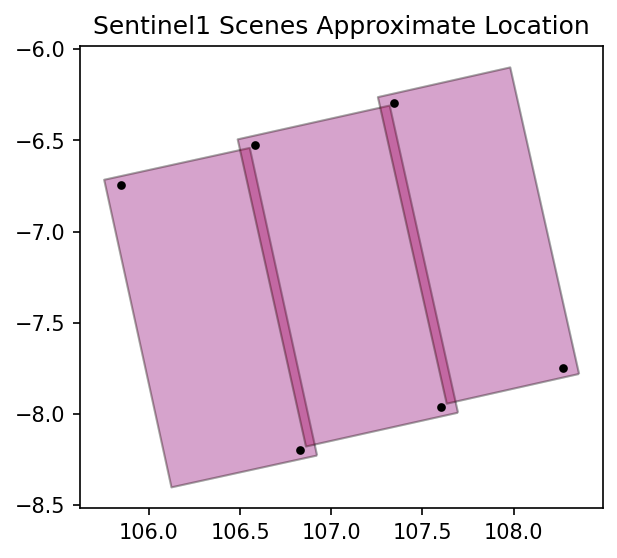

In [ ]:
plt.figure(figsize=(8,4), dpi=150)
gdf = sbas.to_dataframe()
cmap = plt.cm.get_cmap('bwr', len(gdf.index.unique()))
colors = dict([(v,cmap(k)) for k,v in enumerate(gdf.index.unique())])
gdf.reset_index().plot(color=[colors[k] for k in gdf.index], alpha=0.2, edgecolor='black', ax=plt.gca())
plt.scatter(x=sbas.get_pins()[::2], y=sbas.get_pins()[1::2], color='black', s=10)
plt.title('Sentinel1 Scenes Approximate Location', fontsize=12)
plt.show()

### Crop the Frame (Optional)

When we satisfied with the pins positions and the target frame we are ready to crop the frame.
Just comment the code cell below when you don't need to crop the area.

In [ ]:
sbas.reframe_parallel()

Reframing:   0%|          | 0/6 [00:00<?, ?it/s]

### Show the updated dataset

The newly created scene frames .tiff and .xml files plus orbit files .EOF can be copied for the future processing using `SBAS.backup()` function to use them instead of the original full scenes.

In [ ]:
sbas.to_dataframe()

,datetime,orbit,mission,polarization,subswath,datapath,metapath,orbitpath,geometry
date,,,,,,,,,
2022-11-11,2022-11-11 11:15:06,A,S1A,VV,1,raw_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.tiff,raw_cianjur/s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((106.92252 -8.22835, 106.55333 -6.54101, 105.75450 -6.71580, 106.12370 -8.40313, 106.92..."
2022-11-11,2022-11-11 11:15:07,A,S1A,VV,2,raw_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.tiff,raw_cianjur/s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((107.69566 -7.99355, 107.32106 -6.30857, 106.48703 -6.49400, 106.86163 -8.17897, 107.69..."
2022-11-11,2022-11-11 11:15:08,A,S1A,VV,3,raw_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.tiff,raw_cianjur/s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF,"POLYGON ((108.35992 -7.78100, 107.98226 -6.09926, 107.25623 -6.26230, 107.63389 -7.94404, 108.35..."
2023-02-03,2023-02-03 11:15:03,A,S1A,VV,1,raw_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.tiff,raw_cianjur/s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((106.92155 -8.22876, 106.55227 -6.54093, 105.75345 -6.71570, 106.12273 -8.40353, 106.92..."
2023-02-03,2023-02-03 11:15:04,A,S1A,VV,2,raw_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.tiff,raw_cianjur/s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((107.69481 -7.99381, 107.32015 -6.30846, 106.48597 -6.49391, 106.86063 -8.17925, 107.69..."
2023-02-03,2023-02-03 11:15:05,A,S1A,VV,3,raw_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.tiff,raw_cianjur/s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.xml,raw_cianjur/S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.EOF,"POLYGON ((108.35894 -7.78104, 107.98130 -6.09929, 107.25520 -6.26234, 107.63284 -7.94409, 108.35..."


### Download SRTM DEM

The function below downloads SRTM1 or SRTM3 DEM and converts heights to ellipsoidal model using EGM96 grid.
Besides, for faster processing we can use pre-defined DEM file as explained above. Select product=SRTM1 for 30m resolution and product=SRTM3 for 90m resolution SRTM DEM.

In [ ]:
sbas.download_dem(backend='GMT')

DEM Downloading:   0%|          | 0/1 [00:00<?, ?it/s]

### Static Plots

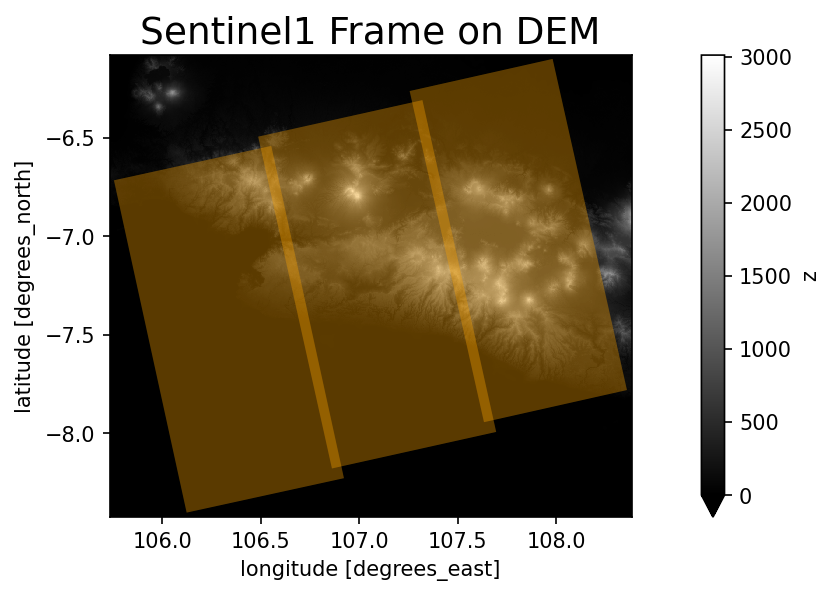

In [ ]:
plt.figure(figsize=(12,4), dpi=150)
dem = sbas.get_dem()
dem[::4,::4].plot.imshow(cmap='gray', vmin=0)
sbas.to_dataframe().plot(color='orange', alpha=0.2, ax=plt.gca())
plt.title('Sentinel1 Frame on DEM', fontsize=18)
plt.show()

## Align a pair of Images

In [ ]:
sbas.stack_parallel()

Reference:   0%|          | 0/3 [00:00<?, ?it/s]

Aligning:   0%|          | 0/3 [00:00<?, ?it/s]

## DEM in Radar Coordinates

In [ ]:
sbas.topo_ra_parallel()

INFO:distributed.utils_perf:full garbage collection released 17.58 MiB from 6797 reference cycles (threshold: 9.54 MiB)


Radar Transform Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.scheduler:Receive client connection: Client-worker-33ceac9a-6e23-11ee-ad0b-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:35212
INFO:distributed.scheduler:Receive client connection: Client-worker-3b85ea70-6e23-11ee-ad09-0242ac1c000c
INFO:distributed.core:Starting established connection to tcp://127.0.0.1:48588


Radar Transform Computing sw2:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Radar Transform Computing sw3:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/28 [00:00<?, ?it/s]

Radar Topography Computing sw1:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/35 [00:00<?, ?it/s]

Radar Topography Computing sw2:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/28 [00:00<?, ?it/s]

Radar Topography Computing sw3:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Load Grids

The grids are NetCDF files processing as xarray DataArrays.

In [ ]:
topo_ra = sbas.get_topo_ra()

### Static Plot

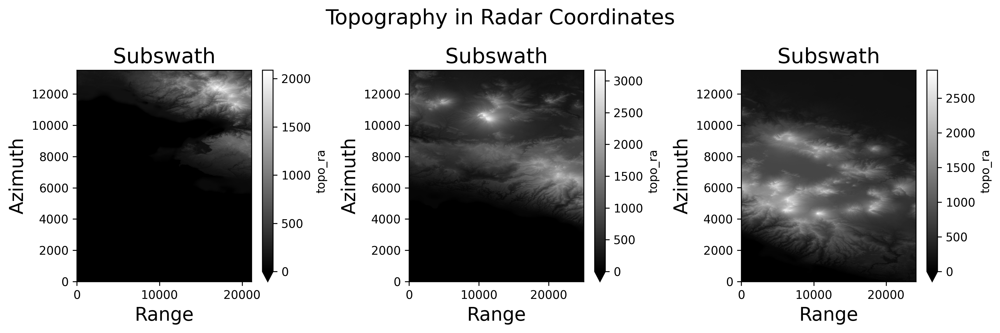

In [ ]:
"""
Hint : Choose only one depend on subswath that you're using
Comment it!
"""

# # This is for only one subswath
# plt.figure(figsize=(12,4), dpi=300)
# topo_ra[::4,::4].plot.imshow(cmap='gray', vmin=0)
# plt.xlabel('Range', fontsize=16)
# plt.ylabel('Azimuth', fontsize=16)
# plt.title('Topography in Radar Coordinates', fontsize=18)
# plt.show()

# ------------------------------------------------------------------------------
# This is for two or more subswath
fig = plt.figure(figsize=(12,4), dpi=300)

subswaths = len(topo_ra)
for subswath in range(subswaths):
    ax = fig.add_subplot(1, subswaths, subswath + 1)
    topo_ra[subswath][::4,::4].plot.imshow(cmap='gray', vmin=0, ax=ax)
    plt.xlabel('Range', fontsize=16)
    plt.ylabel('Azimuth', fontsize=16)
    plt.title('Subswath', fontsize=18)

plt.suptitle('Topography in Radar Coordinates', fontsize=18)
plt.tight_layout()
plt.show()

## Interferogram

Define a single interferogram or a SBAS series. Make direct and reverse interferograms (from past to future or from future to past).

Decimation is useful to save disk space. Geocoding results are always produced on the provided DEM grid so the output grid and resolution are the same to the DEM. By this way, ascending and descending orbit results are always defined on the same grid by design. The internal processing cells is about 15 x 15 meters size and for default output 60m resolution (like to GMTSAR and GAMMA software) decimation 4x4 is reasonable. For the default wavelength=200 for Gaussian filter 1/4 of wavelength is approximately equal to ~60 meters and better resolution is mostly useless (while it can be used for small objects detection). For wavelength=400 meters use 90m or 120m DEM resolution with decimation 6x6 or 8x8 and for wavelength=100 meters use decimation 2x2.

The grids are NetCDF files processing as xarray DataArrays.

In [ ]:
# for a pair of scenes only two interferograms can be produced
# this one is selected for scenes sorted by the date in direct order

# # for one subswath
# pairs = [sbas.to_dataframe().index]

# for two or more subswath
pairs = [sbas.to_dataframe().index.unique()]
pairs

[Index(['2022-11-11', '2023-02-03'], dtype='object', name='date')]

In [ ]:
# use the DEM default resolution 60 m
decimator = sbas.pixel_decimator(resolution_meters=60, debug=True)

# # for one subswath
# # default parameters: wavelength=200, psize=32, func=None (no postprocessing)
# sbas.intf_parallel(pairs, func=decimator)

# ------------------------------------------------------------------------------
# for tow or more subswath
# use all the CPU cores when RAM amount is sufficient, like to Google Colab 12 GB RAM
# limit processing threads for Docker container 4 GB RAM
import psutil
n_jobs = 1 if psutil.virtual_memory().total/1e9 < 8 else -1

# default parameters: wavelength=200, psize=32, func=None (no postprocessing)
sbas.intf_parallel(pairs, func=decimator, n_jobs=n_jobs)

DEBUG: average per subswaths ground pixel size in meters: y=14.0, x=15.0
DEBUG: decimator = lambda da: da.coarsen({'y': 4, 'x': 4}, boundary='trim').mean()


Interferograms:   0%|          | 0/3 [00:00<?, ?it/s]

## Merge Subswaths (Optional)

That's the right time to merge subswath interferograms together before unwrapping them. While unwrapping is possible for separate subswath interferograms the merged interferogram unwrapping is more robust and returns better results when unconnected areas on separate subswaths are connected on the merged interferogram.

In [ ]:
# This is for two or more subswath
sbas.merge_parallel(pairs)

## Build Geocoding Matrices (Optional)

Source grid pixels can be translated to the target grid pixels very fast using the geocoding matrices.

In [ ]:
sbas.geocode_parallel(pairs)

Radar Transform Computing sw123:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/90 [00:00<?, ?it/s]

Radar Topography Computing sw123:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Analyze Transform Blocks:   0%|          | 0/90 [00:00<?, ?it/s]

Build ll2ra Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

Build ra2ll Transform:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

### Load Grids

The grids can be cropped automatically to drop empty areas around valid area (use crop_valid=True). On-the fly geocoding from radar to geographic coordinates is possible by geocode=True.

The grids are NetCDF files in radar coordinates processing as xarray DataArrays. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
phasefilt = sbas.open_grids(pairs, 'phasefilt', geocode=True, crop_valid=True)[0]
corr = sbas.open_grids(pairs, 'corr', geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

### Static Plots

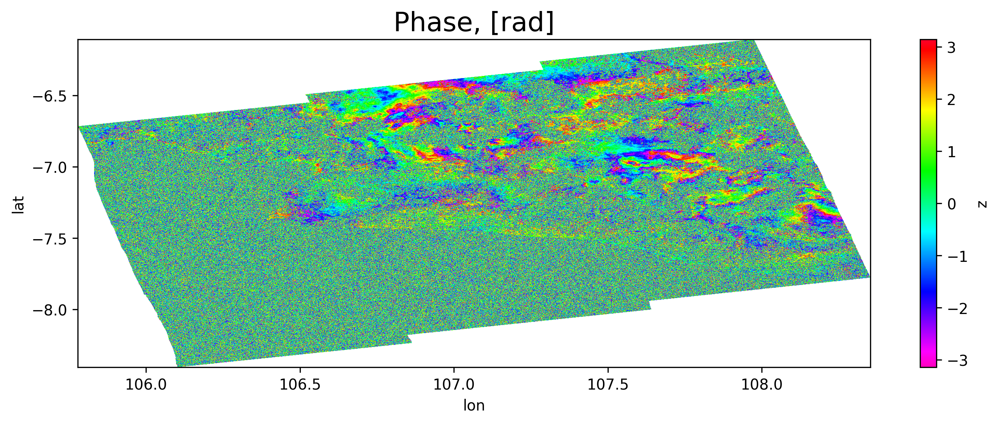

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
phasefilt.plot.imshow(vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r')
plt.title('Phase, [rad]', fontsize=18)
plt.show()

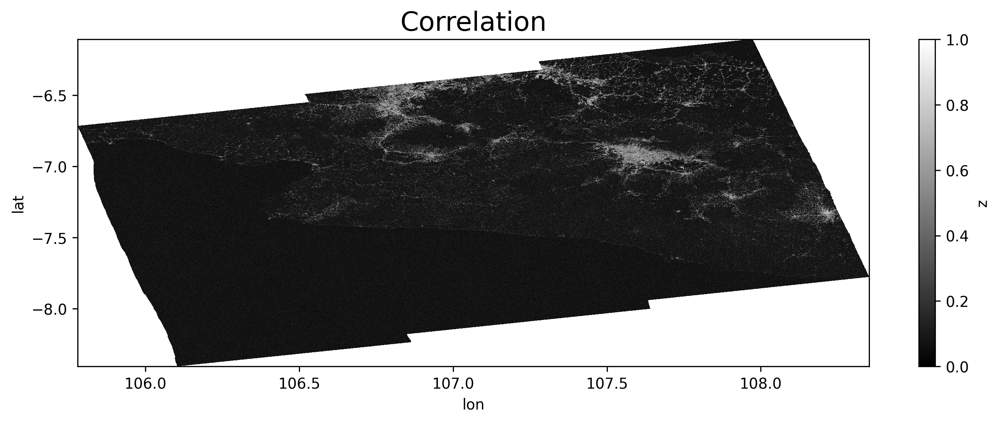

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
corr.plot.imshow(vmin=-0, vmax=1, cmap='gray')
plt.title('Correlation', fontsize=18)
plt.show()

## Unwrapping

Unwrapping process requires a lot of RAM and that's really RAM consuming when a lot of parallel proccesses running togeter. To limit the parallel processing tasks apply argument "n_jobs". The default value n_jobs=-1 means all the processor cores van be used. Also, use interferogram decimation above to produce smaller interferograms. And in addition a custom SNAPHU configuration can reduce RAM usage as explained below.

Attention: in case of crash on MacOS Apple Silicon run Jupyter as

`OBJC_DISABLE_INITIALIZE_FORK_SAFETY=YES no_proxy='*' jupyter notebook`

### Unwrapping Post-Processing

Define post-processing function to exclude low-coherence areas and maybe fill them by nearest neighbour interpolation.

In [ ]:
# define a post-processing function to crop low-coherence areas
cleaner = lambda corr, unwrap: xr.where(corr>=CORRLIMIT, unwrap, np.nan)

# define a post-processing function to crop and interpolate low-coherence areas
#cleaner = lambda corr, unwrap: sbas.nearest_grid(xr.where(corr>=CORRLIMIT, unwrap, np.nan))

### Multiple Interferograms Parallel Unwrapping

### Single Interferogram Parallel Unwrapping

SNAPHU unwrapper allows to split large scene to tiles for parallel processing and accurately enough merge the tiles to a single image. That's especially helpful to unwrap a single interferogram using all the processor cores and save RAM consumption drastically.

### Generate Custom SNAPHU Config

Default SNAPHU configuration allows to run multiple unwrapping tasks in parallel. At the same time, for a single interferogram processing or large interferograms unwrapping SNAPHU tiling can decrease the both processing time and RAM comsumption. Be careful to prevent unconnected zones on the tiles when a high coherency area is fully arounded by low-coherent buffer on some tiles (redefine tiles or increase tiles row and column overlapping parameters ROWOVRLP and COLOVRLP).

In [ ]:
# use NPROC parameter to define number of cores for the processing, by default all the cores used
conf = sbas.PRM().snaphu_config(defomax=DEFOMAX, NTILEROW=1, NTILECOL=8, ROWOVRLP=200, COLOVRLP=200)

In [ ]:
# check the generated SNAPHU config and tune the SNAPHU parameters above if needed.
print ('SNAPHU custom config generated:')
print (conf)

SNAPHU custom config generated:

        # basic config
        INFILEFORMAT   FLOAT_DATA
        OUTFILEFORMAT  FLOAT_DATA
        AMPFILEFORMAT  FLOAT_DATA
        CORRFILEFORMAT FLOAT_DATA
        ALTITUDE       693000.0
        EARTHRADIUS    6378000.0
        NEARRANGE      831000
        DR             18.4
        DA             28.2
        RANGERES       28
        AZRES          44
        LAMBDA         0.0554658
        NLOOKSRANGE    1
        NLOOKSAZ       1
        TILEDIR        raw_cianjur/S1_20221111_ALL_F123_snaphu_tiledir
        NPROC          2
        # custom config
        DEFOMAX_CYCLE 0
        NTILEROW 1
        NTILECOL 8
        ROWOVRLP 200
        COLOVRLP 200



In [ ]:
# "FileNotFoundError" SNAPHU error means the processing is not completed normally for some tiles
# try again with different SNAPHU parameters

# miss "func" argument or set it to None when post-processing is not required
# run only one unwrapping task at the time because the custom SNAPHU configuration already uses all the cores
sbas.unwrap_parallel(pairs, n_jobs=1, threshold=CORRLIMIT, func=cleaner, conf=conf)

Unwrapping:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 282.77 MiB from 11396 reference cycles (threshold: 9.54 MiB)


### Load Grid

The grids can be cropped automatically to drop empty areas around valid area. Use `open_grids(..., crop_valid=True)` to enable the auto cropping feature. Argument geocode=True means on-the-fly geocoding from radar to geographic coordinates (all the grids saved on disk in radar coordinates plus geocoding matrices are generated for the fast geocoding). For a single interferogramm processing we convert the 3D stack to 2D grid using index [0].

In [ ]:
unwrap = sbas.open_grids(pairs, 'unwrap', geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

### Static Plot

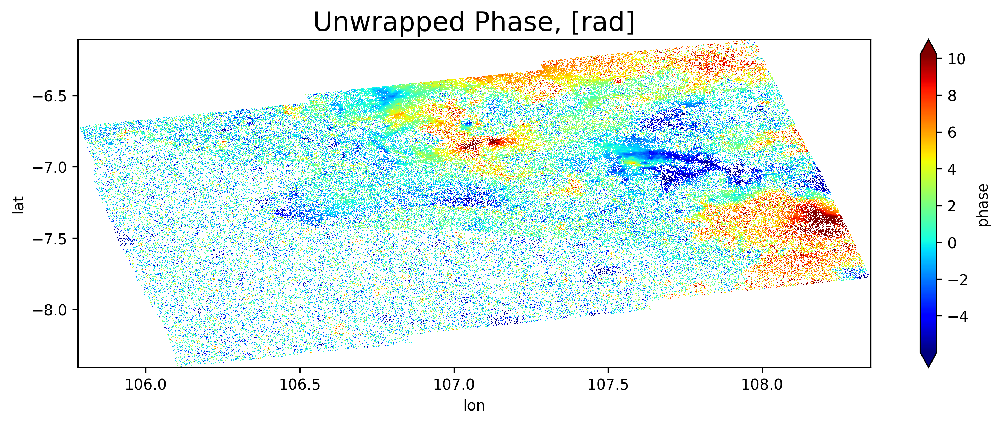

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(unwrap, [0.01, 0.99])
unwrap.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
plt.title('Unwrapped Phase, [rad]', fontsize=18)
plt.show()

## LOS Displacement

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS function `los_displacement_mm()` converts unwrapped phase values to LOS displacement in millimeters. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
los_disp_mm = sbas.open_grids(pairs, 'unwrap', func=sbas.los_displacement_mm, geocode=True, crop_valid=True)[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 191.69 MiB from 6358 reference cycles (threshold: 9.54 MiB)


### Static Plot

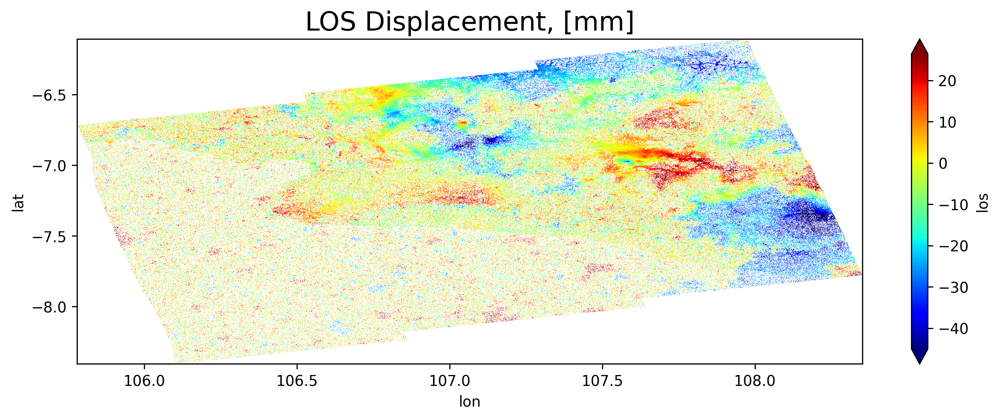

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(los_disp_mm, [0.01, 0.99])
los_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
plt.title('LOS Displacement, [mm]', fontsize=18)
plt.show()

## Measure Maximum and Minimum LOS Displacement, [mm]

In [ ]:
np.array(los_disp_mm.min().round()), np.array(los_disp_mm.max().round())

(array(-85., dtype=float32), array(82., dtype=float32))

## Compare Results to GMTSAR, GAMMA, SNAP

* PyGMTSAR results full subswath 3 for LOS displacement depends a bit of the unwrapping method above:

  - 85.8 cm up and 15 cm down with amplitude 100.8 cm for a single-image unwrapping,
  - 87.5 cm up and 15 cm down with amplitude 102.5 cm for tiled unwrapping.

Pay attention for the cropped subswath the results are different (83 cm up and 20 cm down). Run the notebook without pinning to produce the full subswath results.

* GAMMA software package results: [Co-Seismic Deformation and Fault Slip Model of the 2017 Mw 7.3 Darbandikhan, Iran–Iraq Earthquake Inferred from D-InSAR Measurements](https://www.mdpi.com/2072-4292/11/21/2521/htm). The reported amplitude is 84 cm + 15 cm = 99 cm and it's very close to PyGMTSAR measured 100.8 cm for single-image unwrapping:

> for the ascending orbit the maximum value in the southwestern lobe of about 84 cm,
> and the minimum value in the northeastern lobe along the line-of-sight (LOS) of 15 cm.


* Ustream GMTSAR results: [Surface Displacements of the 12 November 2017 Iran – Iraq Earthquake derived using SAR Interferometry](https://www.researchgate.net/publication/333108916_Surface_Displacements_of_the_12_November_2017_Iran_-_Iraq_Earthquake_derived_using_SAR_Interferometry) The reported amplitude is 80 cm + 22 cm = 102 cm and it's almost equal to PyGMTSAR measured 102.5 cm for tiled unwrapping:

> The coseismic LOS displacements corresponding to the uplift and subsidence are observed to be ... +0.80 m and -0.22 m for the Sentinel-1 ascending

* SNAP processing instructions and output interferogram: [Creating Interferogram for Mapping Earthquake Deformation by using Sentinel-1 Data in SNAP](https://dges.carleton.ca/CUOSGwiki/index.php/Creating_Interferogram_for_Mapping_Earthquake_Deformation_by_using_Sentinel-1_Data_in_SNAP) While there is no unwrapping processing here we are able to compare the interferograms, see plots below.

### Download SNAP Interferogram

In [ ]:
# sometimes the server does not respond
url = "https://dges.carleton.ca/CUOSGwiki/images/thumb/b/b1/Step12_II.JPG/1400px-Step12_II.JPG"
!wget -qc {url}

### Static Plot

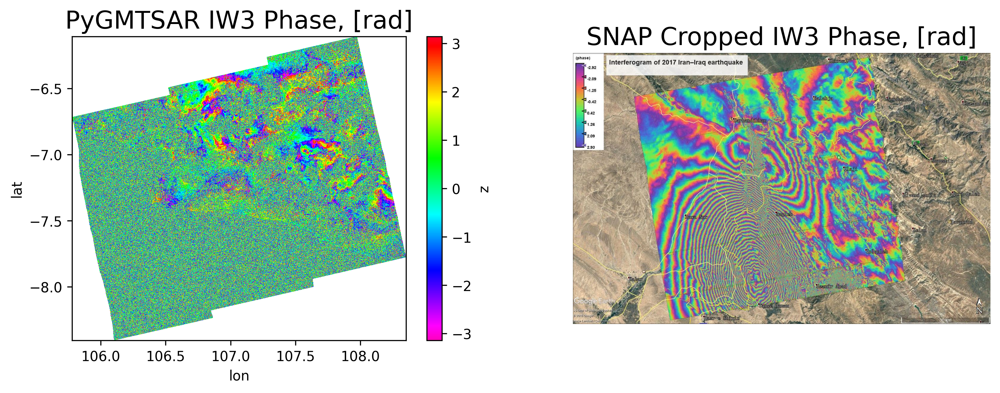

In [ ]:
# check if the file is downloaded
if os.path.exists('1400px-Step12_II.JPG'):
  f, (ax1, ax2) = plt.subplots(1,2,figsize=(12,4), dpi=300)
  phasefilt.plot.imshow(vmin=-np.pi, vmax=np.pi, cmap='gist_rainbow_r', ax=ax1)
  ax1.set_title('PyGMTSAR IW3 Phase, [rad]', fontsize=18)

  from skimage import io
  img = io.imread('1400px-Step12_II.JPG')
  ax2.imshow(img)
  ax2.axis('off')
  ax2.set_title('SNAP Cropped IW3 Phase, [rad]', fontsize=18)

  plt.show()

## Vertical and East-West Displacements

LOS displacement projections as vertical and east-west displacements can be calculated using incidence angle defined on the grid.

In [ ]:
sbas.sat_look_parallel()

Satellite Look Vector Computing:   0%|          | 0/9000000.0 [00:00<?, ?it/s]

INFO:distributed.utils_perf:full garbage collection released 73.05 MiB from 6266 reference cycles (threshold: 9.54 MiB)


In [ ]:
incidence_angle = sbas.incidence_angle()

### Static Plot

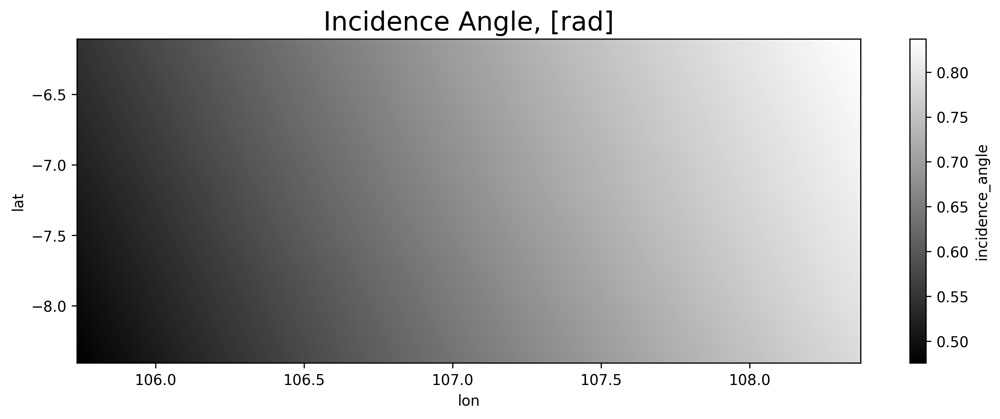

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
incidence_angle.plot.imshow(cmap='gray')
plt.title('Incidence Angle, [rad]', fontsize=18)
plt.show()

### Load and Calculate Grid

The grids can be post-processed using user-defined function "func". SBAS functions `vertical_displacement_mm()` and `eastwest_displacement_mm()` convert unwrapped phase values to vertical and East-West displacements in millimeters. For a single interferogramm processing convert the 3D stack to 2D grid using index [0].

In [ ]:
# fill small gaps, georeference grid, calculate displacements, mask using landmask in geographic coordinates
interp = lambda grid: sbas.nearest_grid(grid, search_radius_pixels=10)
vert_disp_mm = sbas.open_grids(pairs, 'unwrap', func=[interp, sbas.intf_ra2ll, sbas.vertical_displacement_mm])[0]
east_disp_mm = sbas.open_grids(pairs, 'unwrap', func=[interp, sbas.intf_ra2ll, sbas.eastwest_displacement_mm])[0]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

Loading:   0%|          | 0/1 [00:00<?, ?it/s]

## Static Plots

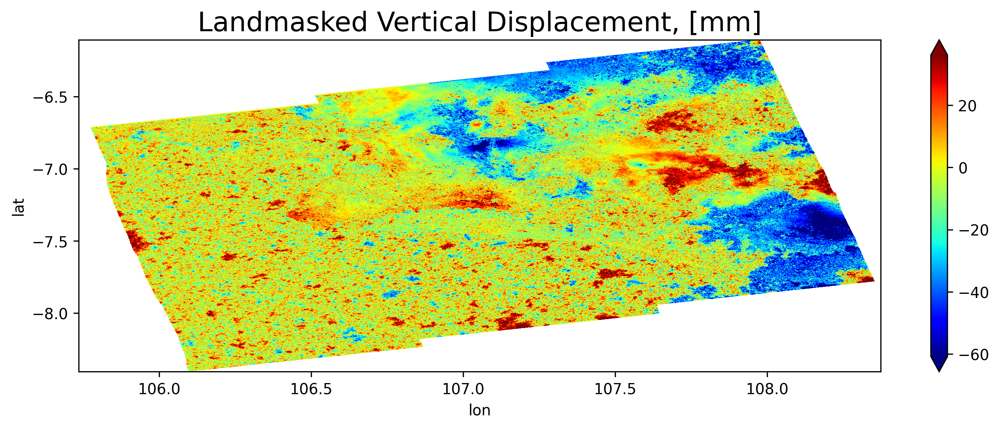

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(vert_disp_mm, [0.01, 0.99])
vert_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
plt.title('Landmasked Vertical Displacement, [mm]', fontsize=18)
plt.show()

INFO:distributed.utils_perf:full garbage collection released 228.48 MiB from 11906 reference cycles (threshold: 9.54 MiB)


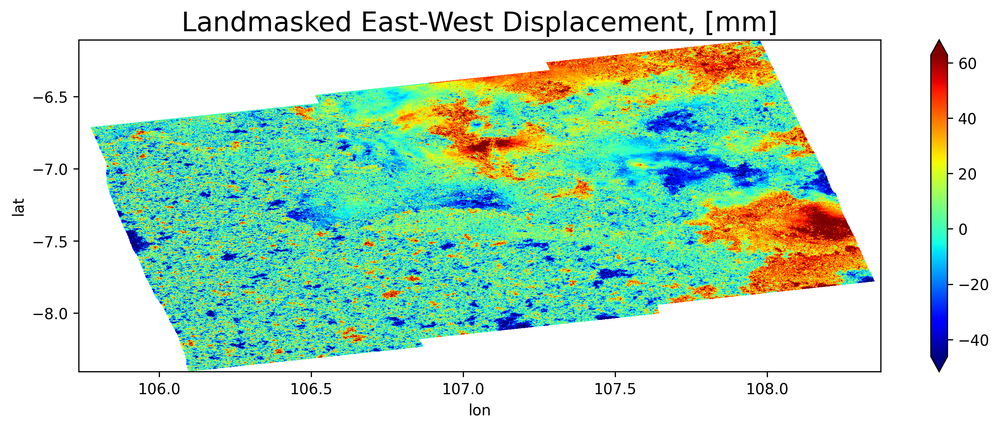

In [ ]:
plt.figure(figsize=(12,4), dpi=300)
zmin, zmax = np.nanquantile(east_disp_mm, [0.01, 0.99])
east_disp_mm.plot.imshow(vmin=zmin, vmax=zmax, cmap='jet')
plt.title('Landmasked East-West Displacement, [mm]', fontsize=18)
plt.show()

## Save the Results

Save the results in geospatial data formats like to NetCDF, GeoTIFF and others. The both formats (NetCDF and GeoTIFF) can be opened in QGIS and other GIS applications.

In [ ]:
# define the filenames for phase, correlation, LOS displacement
phasefilt_filename = f'phasefilt_iw{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
corr_filename = f'corr_iw{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
displacement_filename = f'los_disp_mm_iw{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
unwrap_filename = f'unwrap_iw{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
incidence_angle_filename = f'incidence_angle_rad{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
vert_disp_mm_filename = f'vert_disp_mm{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'
east_disp_mm_filename = f'east_disp_mm{SUBSWATH}_{POLARIZATION}_{ORBIT}.nc'

# save the results
phasefilt.to_netcdf(phasefilt_filename, engine=sbas.engine)
corr.to_netcdf(corr_filename, engine=sbas.engine)
los_disp_mm.to_netcdf(displacement_filename, engine=sbas.engine)
unwrap.to_netcdf(unwrap_filename, engine=sbas.engine)
incidence_angle.to_netcdf(incidence_angle_filename, engine=sbas.engine)
vert_disp_mm.to_netcdf(vert_disp_mm_filename, engine=sbas.engine)
east_disp_mm.to_netcdf(east_disp_mm_filename, engine=sbas.engine)

INFO:distributed.utils_perf:full garbage collection released 75.00 MiB from 6233 reference cycles (threshold: 9.54 MiB)


### Export from Google Colab

In [ ]:
if 'google.colab' in sys.modules:
    from google.colab import files
    files.download(phasefilt_filename)
    files.download(corr_filename)
    files.download(displacement_filename)
    files.download(unwrap_filename)
    files.download(incidence_angle_filename)
    files.download(vert_disp_mm_filename)
    files.download(east_disp_mm_filename)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Backup Pre-Processed Data

Save the stitched and cropped scenes and downloaded DEM and orbit files to a new directory using `SBAS.backup(dir)` command and load the dataset later as `SBAS(dir, 'dir/DEM_WGS84.nc', basedir=WORKDIR)` Do not forgot to download the backup to use it later.

In [ ]:
if DATADIR != 'backup':
    print ('Create backup to use it for the next reproducible runs without the original scenes downloading')
    sbas.backup('backup')

Create backup to use it for the next reproducible runs without the original scenes downloading


In [ ]:
!ls backup

DEM_WGS84.nc
s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.tiff
s1a-iw1-slc-vv-20221111t111506-20221111t111534-045845-057c1d-004.xml
s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.tiff
s1a-iw1-slc-vv-20230203t111503-20230203t111531-047070-05a589-004.xml
s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.tiff
s1a-iw2-slc-vv-20221111t111507-20221111t111535-045845-057c1d-005.xml
s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.tiff
s1a-iw2-slc-vv-20230203t111504-20230203t111532-047070-05a589-005.xml
s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.tiff
s1a-iw3-slc-vv-20221111t111508-20221111t111536-045845-057c1d-006.xml
s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.tiff
s1a-iw3-slc-vv-20230203t111505-20230203t111533-047070-05a589-006.xml
S1A_OPER_AUX_POEORB_OPOD_20221201T081741_V20221110T225942_20221112T005942.EOF
S1A_OPER_AUX_POEORB_OPOD_20230223T080750_V20230202T225942_20230204T005942.E

## Conclusion

For now you have the full control on interferometry processing and unwrapping and able to run it everywhere: on free of charge Google Colab instances, on local MacOS and Linux computers and on Amazon EC2 and Google Cloud VM and AI Notebook instances.